In [1]:
import pandas as pd
import re
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import preprocessing
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 150)

In [2]:
#! pip install cufflinks
import plotly.offline as py 
#py.init_notebook_mode(connected=True) # this code, allow us to work with offline plotly version
import plotly.graph_objs as go # it's like "plt" of matplot
import plotly.tools as tls # It's useful to we get some tools of plotly
import warnings # This library will be used to ignore some warnings
from collections import Counter # To do counter of some features
import plotly.io as pio
#import all required libraries
#Data Analysis
import pandas as pd
import numpy as np
import json
#Visulaization libraries
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.palettes import Viridis5
import seaborn as sns
import matplotlib.pyplot as plt
import pygal
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
#model developemnt libraries


In [3]:
df = pd.read_csv("loan.csv")
print(df.shape)
df.head()

C:\Users\LOKSUNDAR\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning:

Columns (47) have mixed types.Specify dtype option on import or set low_memory=False.



(39717, 111)


,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,NaN,NaN,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0,Feb-96,1,35.0,NaN,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,NaN,Apr-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [4]:
df.isna().sum()[df.isna().sum()/len(df)>0]/len(df)

emp_title                         0.061913
emp_length                        0.027066
desc                              0.325805
title                             0.000277
mths_since_last_delinq            0.646625
mths_since_last_record            0.929854
revol_util                        0.001259
last_pymnt_d                      0.001788
next_pymnt_d                      0.971297
last_credit_pull_d                0.000050
collections_12_mths_ex_med        0.001410
mths_since_last_major_derog       1.000000
annual_inc_joint                  1.000000
dti_joint                         1.000000
verification_status_joint         1.000000
tot_coll_amt                      1.000000
tot_cur_bal                       1.000000
open_acc_6m                       1.000000
open_il_6m                        1.000000
open_il_12m                       1.000000
open_il_24m                       1.000000
mths_since_rcnt_il                1.000000
total_bal_il                      1.000000
il_util    

* we can observe that emp_title is missing 6% data so we can impute mode for these 6% values.
* we can also see that emp_length is missing 2.7%data , so we can impute mode for these values.

In [5]:
df["emp_title"].fillna(df["emp_title"].mode()[0],inplace=True)
df["emp_length"].fillna(df["emp_length"].mode()[0],inplace=True)

In [6]:
df['home_ownership'].replace('NONE', "RENT", inplace=True)

* Ithink we can simply remove desc column because its not categorical or nmerical its not possible to impute missing values


In [7]:
df["title"].fillna(df["title"].mode()[0],inplace=True)

In [8]:
df["mths_since_last_delinq"]

0         NaN
1         NaN
2         NaN
3        35.0
4        38.0
         ... 
39712     0.0
39713     5.0
39714     0.0
39715     0.0
39716    11.0
Name: mths_since_last_delinq, Length: 39717, dtype: float64

In [9]:
df["revol_util"]=df["revol_util"].str.split("%",expand=True)[0].astype(float)

In [10]:
df["revol_util"].fillna(df["revol_util"].mean(),inplace=True)

In [11]:
df["last_pymnt_d"].fillna(df["last_pymnt_d"].mode()[0],inplace=True)

In [12]:
df["last_credit_pull_d"].fillna(df["last_credit_pull_d"].mode()[0],inplace=True)

In [13]:
df["collections_12_mths_ex_med"].value_counts()

0.0    39661
Name: collections_12_mths_ex_med, dtype: int64

* we can remove this column as all the entries are only zero.

In [14]:
df["chargeoff_within_12_mths"].value_counts()

0.0    39661
Name: chargeoff_within_12_mths, dtype: int64

In [15]:
df["pub_rec_bankruptcies"].value_counts()

0.0    37339
1.0     1674
2.0        7
Name: pub_rec_bankruptcies, dtype: int64

In [16]:
df["pub_rec_bankruptcies"].fillna(df["pub_rec_bankruptcies"].mode()[0],inplace=True)

In [17]:
df["tax_liens"].value_counts()

0.0    39678
Name: tax_liens, dtype: int64

In [18]:
x=df.isna().sum()[df.isna().sum()/len(df)>0]/len(df)
x

desc                              0.325805
mths_since_last_delinq            0.646625
mths_since_last_record            0.929854
next_pymnt_d                      0.971297
collections_12_mths_ex_med        0.001410
mths_since_last_major_derog       1.000000
annual_inc_joint                  1.000000
dti_joint                         1.000000
verification_status_joint         1.000000
tot_coll_amt                      1.000000
tot_cur_bal                       1.000000
open_acc_6m                       1.000000
open_il_6m                        1.000000
open_il_12m                       1.000000
open_il_24m                       1.000000
mths_since_rcnt_il                1.000000
total_bal_il                      1.000000
il_util                           1.000000
open_rv_12m                       1.000000
open_rv_24m                       1.000000
max_bal_bc                        1.000000
all_util                          1.000000
total_rev_hi_lim                  1.000000
inq_fi     

In [19]:
del_cols = list(dict(x).keys())
del_cols

['desc',
 'mths_since_last_delinq',
 'mths_since_last_record',
 'next_pymnt_d',
 'collections_12_mths_ex_med',
 'mths_since_last_major_derog',
 'annual_inc_joint',
 'dti_joint',
 'verification_status_joint',
 'tot_coll_amt',
 'tot_cur_bal',
 'open_acc_6m',
 'open_il_6m',
 'open_il_12m',
 'open_il_24m',
 'mths_since_rcnt_il',
 'total_bal_il',
 'il_util',
 'open_rv_12m',
 'open_rv_24m',
 'max_bal_bc',
 'all_util',
 'total_rev_hi_lim',
 'inq_fi',
 'total_cu_tl',
 'inq_last_12m',
 'acc_open_past_24mths',
 'avg_cur_bal',
 'bc_open_to_buy',
 'bc_util',
 'chargeoff_within_12_mths',
 'mo_sin_old_il_acct',
 'mo_sin_old_rev_tl_op',
 'mo_sin_rcnt_rev_tl_op',
 'mo_sin_rcnt_tl',
 'mort_acc',
 'mths_since_recent_bc',
 'mths_since_recent_bc_dlq',
 'mths_since_recent_inq',
 'mths_since_recent_revol_delinq',
 'num_accts_ever_120_pd',
 'num_actv_bc_tl',
 'num_actv_rev_tl',
 'num_bc_sats',
 'num_bc_tl',
 'num_il_tl',
 'num_op_rev_tl',
 'num_rev_accts',
 'num_rev_tl_bal_gt_0',
 'num_sats',
 'num_tl_120dpd

In [20]:
df.drop(columns=del_cols,inplace=True)

In [21]:
df.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'purpose', 'title',
       'zip_code', 'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
       'total_acc', 'initial_list_status', 'out_prncp', 'out_prncp_inv',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d', 'policy_code',
       'application_type', 'acc_now_delinq', 'delinq_amnt',
       'pub_rec_bankruptcies'],
      dtype='object')

In [22]:
df.shape

(39717, 50)

In [23]:
df["loan_status"].value_counts()

Fully Paid     32950
Charged Off     5627
Current         1140
Name: loan_status, dtype: int64

In [24]:
codf= df[df["loan_status"]=="Charged Off"]
codf.shape

(5627, 50)

In [25]:
df.corr()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,policy_code,acc_now_delinq,delinq_amnt,pub_rec_bankruptcies
id,1.000000,0.993650,0.141919,0.152286,0.249547,0.086587,0.008731,0.095983,-0.008644,-0.042378,0.020388,-0.019440,0.008763,0.094772,0.042149,0.180619,0.180591,0.140045,0.220838,0.112213,0.172856,-0.055082,0.033426,-0.013359,0.122365,NaN,NaN,NaN,-0.000569
member_id,0.993650,1.000000,0.140710,0.150322,0.257887,0.081025,0.009380,0.096963,-0.008119,-0.047086,0.017928,-0.018721,0.005113,0.093032,0.044374,0.170743,0.170706,0.139975,0.229307,0.112168,0.173234,-0.057750,0.031565,-0.015155,0.123627,NaN,NaN,NaN,0.000809
loan_amnt,0.141919,0.140710,1.000000,0.981578,0.940034,0.930288,0.271149,0.066439,-0.031864,0.009229,0.177168,-0.051236,0.317597,0.066107,0.256442,0.192937,0.192623,0.886613,0.854243,0.852021,0.729726,0.044706,0.135446,0.072853,0.448742,NaN,NaN,NaN,-0.036284
funded_amnt,0.152286,0.150322,0.981578,1.000000,0.958422,0.956159,0.266965,0.066283,-0.032355,0.009259,0.175530,-0.052169,0.310392,0.069917,0.250589,0.194941,0.194675,0.903160,0.870799,0.870255,0.737469,0.046705,0.136284,0.074676,0.453133,NaN,NaN,NaN,-0.037636
funded_amnt_inv,0.249547,0.257887,0.940034,0.958422,1.000000,0.905039,0.254375,0.074689,-0.038501,-0.005712,0.163027,-0.053214,0.290797,0.074891,0.242854,0.203688,0.203693,0.881228,0.913257,0.845848,0.730914,0.027172,0.123759,0.060358,0.442604,NaN,NaN,NaN,-0.037982
installment,0.086587,0.081025,0.930288,0.956159,0.905039,1.000000,0.270874,0.054186,-0.019657,0.009722,0.172812,-0.046532,0.312679,0.095427,0.230824,0.125082,0.124932,0.856928,0.817416,0.850773,0.634725,0.056709,0.118152,0.075467,0.401688,NaN,NaN,NaN,-0.033746
annual_inc,0.008731,0.009380,0.271149,0.266965,0.254375,0.270874,1.000000,-0.122732,0.023083,0.033908,0.158200,-0.018689,0.279961,0.017914,0.235771,0.033573,0.033472,0.257980,0.247119,0.259571,0.185476,0.006243,0.021589,0.015604,0.140401,NaN,NaN,NaN,-0.016514
dti,0.095983,0.096963,0.066439,0.066283,0.074689,0.054186,-0.122732,1.000000,-0.034452,0.001405,0.288045,-0.004621,0.228743,0.277709,0.229881,0.036095,0.036012,0.064766,0.071647,0.041316,0.106071,-0.011781,0.024878,0.011033,0.005212,NaN,NaN,NaN,0.007021
delinq_2yrs,-0.008644,-0.008119,-0.031864,-0.032355,-0.038501,-0.019657,0.023083,-0.034452,1.000000,0.008091,0.011656,0.007463,-0.055125,-0.043049,0.067892,-0.003008,-0.003203,-0.022695,-0.028976,-0.038795,0.023077,0.030609,0.012315,0.013912,-0.012149,NaN,NaN,NaN,0.002954
inq_last_6mths,-0.042378,-0.047086,0.009229,0.009259,-0.005712,0.009722,0.033908,0.001405,0.008091,1.000000,0.091713,0.024802,-0.022381,-0.068554,0.111499,-0.012106,-0.011780,-0.010559,-0.020277,-0.023433,0.021774,0.031215,0.018972,0.012420,0.028514,NaN,NaN,NaN,0.015652


In [26]:
df["acc_now_delinq"].value_counts()

0    39717
Name: acc_now_delinq, dtype: int64

<AxesSubplot:>

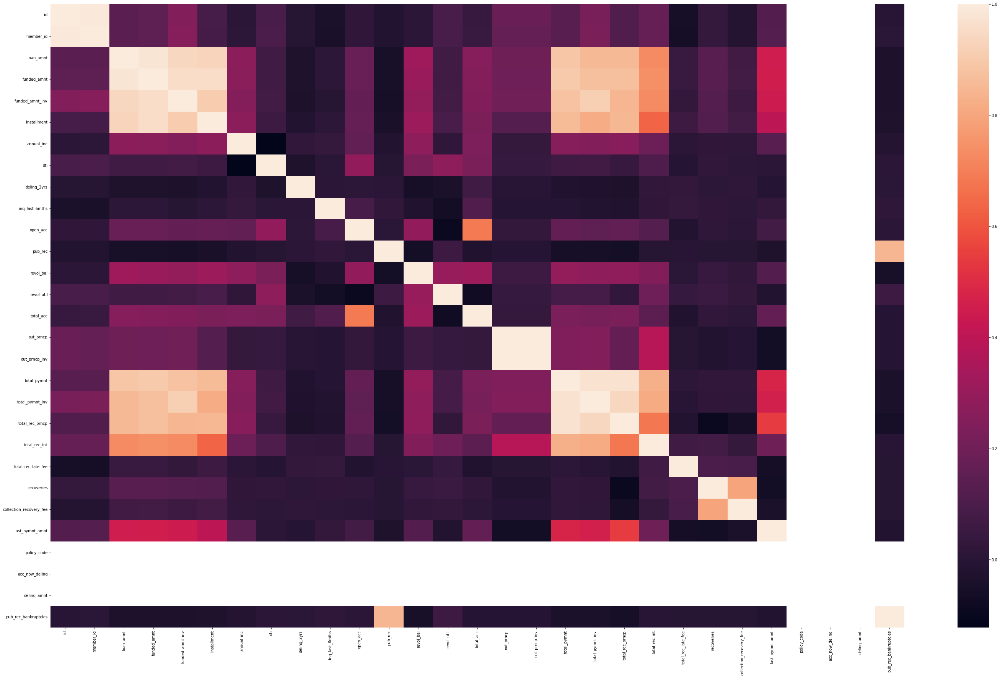

In [27]:
data_correlation = df.corr()
plt.rcParams["figure.figsize"] = [50,30]#corellation graph
sns.heatmap(data_correlation,xticklabels=data_correlation.columns,yticklabels=data_correlation.columns)

In [28]:
print(df.columns)

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'purpose', 'title',
       'zip_code', 'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
       'total_acc', 'initial_list_status', 'out_prncp', 'out_prncp_inv',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d', 'policy_code',
       'application_type', 'acc_now_delinq', 'delinq_amnt',
       'pub_rec_bankruptcies'],
      dtype='object')


In [29]:
df.describe()


,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,policy_code,acc_now_delinq,delinq_amnt,pub_rec_bankruptcies
count,3.971700e+04,3.971700e+04,39717.000000,39717.000000,39717.000000,39717.000000,3.971700e+04,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.0,39717.0,39717.0,39717.000000
mean,6.831319e+05,8.504636e+05,11219.443815,10947.713196,10397.448868,324.561922,6.896893e+04,13.315130,0.146512,0.869200,9.294408,0.055065,13382.528086,48.832152,22.088828,51.227887,50.989768,12153.596544,11567.149118,9793.348813,2263.663172,1.363015,95.221624,12.406112,2678.826162,1.0,0.0,0.0,0.042501
std,2.106941e+05,2.656783e+05,7456.670694,7187.238670,7128.450439,208.874874,6.379377e+04,6.678594,0.491812,1.070219,4.400282,0.237200,15885.016641,28.314793,11.401709,375.172839,373.824457,9042.040766,8942.672613,7065.522127,2608.111964,7.289979,688.744771,148.671593,4447.136012,0.0,0.0,0.0,0.202603
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,15.690000,4.000000e+03,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.0,0.0,0.000000
25%,5.162210e+05,6.667800e+05,5500.000000,5400.000000,5000.000000,167.020000,4.040400e+04,8.170000,0.000000,0.000000,6.000000,0.000000,3703.000000,25.500000,13.000000,0.000000,0.000000,5576.930000,5112.310000,4600.000000,662.180000,0.000000,0.000000,0.000000,218.680000,1.0,0.0,0.0,0.000000
50%,6.656650e+05,8.508120e+05,10000.000000,9600.000000,8975.000000,280.220000,5.900000e+04,13.400000,0.000000,1.000000,9.000000,0.000000,8850.000000,49.200000,20.000000,0.000000,0.000000,9899.640319,9287.150000,8000.000000,1348.910000,0.000000,0.000000,0.000000,546.140000,1.0,0.0,0.0,0.000000
75%,8.377550e+05,1.047339e+06,15000.000000,15000.000000,14400.000000,430.780000,8.230000e+04,18.600000,0.000000,1.000000,12.000000,0.000000,17058.000000,72.300000,29.000000,0.000000,0.000000,16534.433040,15798.810000,13653.260000,2833.400000,0.000000,0.000000,0.000000,3293.160000,1.0,0.0,0.0,0.000000
max,1.077501e+06,1.314167e+06,35000.000000,35000.000000,35000.000000,1305.190000,6.000000e+06,29.990000,11.000000,8.000000,44.000000,4.000000,149588.000000,99.900000,90.000000,6311.470000,6307.370000,58563.679930,58563.680000,35000.020000,23563.680000,180.200000,29623.350000,7002.190000,36115.200000,1.0,0.0,0.0,2.000000


In [30]:
cat_cols=[]
for i in df.columns:
    if df[i].dtype==object:
        cat_cols.append(i)
cat_cols

['term',
 'int_rate',
 'grade',
 'sub_grade',
 'emp_title',
 'emp_length',
 'home_ownership',
 'verification_status',
 'issue_d',
 'loan_status',
 'pymnt_plan',
 'url',
 'purpose',
 'title',
 'zip_code',
 'addr_state',
 'earliest_cr_line',
 'initial_list_status',
 'last_pymnt_d',
 'last_credit_pull_d',
 'application_type']

In [31]:
df["term"] = df["term"].str.split(expand=True)[0].astype(int)

In [32]:
df["int_rate"]=df["int_rate"].str.replace("%","").astype(float)

In [33]:
len(df["grade"].value_counts())

7

In [34]:
len(df["sub_grade"].value_counts())

35

In [35]:
len(df["emp_title"].value_counts())  # no encoding

28820

In [36]:
noenc = ["emp_title"]

In [37]:
df["emp_length"] = df["emp_length"].apply(lambda x:int(re.search(r'\d+', x).group()))

In [38]:
len(df["home_ownership"].value_counts()) 

4

In [39]:
len(df["verification_status"].value_counts())

3

In [40]:
df["issue_d"]=df["issue_d"].apply(lambda x:datetime.strptime(x, '%b-%y'))

In [41]:
df["loan_status"].value_counts()

Fully Paid     32950
Charged Off     5627
Current         1140
Name: loan_status, dtype: int64

In [42]:
df["pymnt_plan"].value_counts() # no use 

n    39717
Name: pymnt_plan, dtype: int64

In [43]:
df.drop(columns="pymnt_plan",inplace=True)

In [44]:
df["url"]  #no encoding

0        https://lendingclub.com/browse/loanDetail.acti...
1        https://lendingclub.com/browse/loanDetail.acti...
2        https://lendingclub.com/browse/loanDetail.acti...
3        https://lendingclub.com/browse/loanDetail.acti...
4        https://lendingclub.com/browse/loanDetail.acti...
                               ...                        
39712    https://lendingclub.com/browse/loanDetail.acti...
39713    https://lendingclub.com/browse/loanDetail.acti...
39714    https://lendingclub.com/browse/loanDetail.acti...
39715    https://lendingclub.com/browse/loanDetail.acti...
39716    https://lendingclub.com/browse/loanDetail.acti...
Name: url, Length: 39717, dtype: object

In [45]:
df.drop(columns="url",inplace=True)

In [46]:
len(df["purpose"].value_counts())

14

In [47]:
len(df["title"].value_counts()) # no encoding

19615

In [48]:
noenc.append("title")

In [49]:
len(df["zip_code"].value_counts()) # no encoding

823

In [50]:
noenc.append("zip_code")

In [51]:
len(df["addr_state"].value_counts())

50

In [52]:
df["earliest_cr_line"] = df["earliest_cr_line"].apply(lambda x:datetime.strptime(x, '%b-%y'))

In [53]:
df["initial_list_status"].value_counts() # no use

f    39717
Name: initial_list_status, dtype: int64

In [54]:
df.drop(columns="initial_list_status",inplace=True)

In [55]:
df["last_pymnt_d"] = df["last_pymnt_d"].apply(lambda x:datetime.strptime(x, '%b-%y'))

In [56]:
df["last_credit_pull_d"] = df["last_credit_pull_d"].apply(lambda x:datetime.strptime(x, '%b-%y'))

In [57]:
df["application_type"].value_counts() # no use.

INDIVIDUAL    39717
Name: application_type, dtype: int64

In [58]:
df.drop(columns="application_type",inplace=True)

In [59]:
cat_cols=[]
for i in df.columns:
    if df[i].dtype==object:
        cat_cols.append(i)
cat_cols

['grade',
 'sub_grade',
 'emp_title',
 'home_ownership',
 'verification_status',
 'loan_status',
 'purpose',
 'title',
 'zip_code',
 'addr_state']

In [60]:
noenc

['emp_title', 'title', 'zip_code']

In [61]:
for i in noenc:
    cat_cols.remove(i)

In [62]:
cat_cols

['grade',
 'sub_grade',
 'home_ownership',
 'verification_status',
 'loan_status',
 'purpose',
 'addr_state']

In [63]:
categorical_column =cat_cols
data_encoded = df.copy(deep=True)#deep copying
lab_enc = preprocessing.LabelEncoder()
for col in categorical_column:
        data_encoded[col] = lab_enc.fit_transform(df[col])#column names keeping same
        le_name_mapping = dict(zip(lab_enc.classes_, lab_enc.transform(lab_enc.classes_)))#automatic labeling
        print('Feature : ', col)#printing All 
        print('\t mapping : ', le_name_mapping)

Feature :  grade
	 mapping :  {'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5, 'G': 6}
Feature :  sub_grade
	 mapping :  {'A1': 0, 'A2': 1, 'A3': 2, 'A4': 3, 'A5': 4, 'B1': 5, 'B2': 6, 'B3': 7, 'B4': 8, 'B5': 9, 'C1': 10, 'C2': 11, 'C3': 12, 'C4': 13, 'C5': 14, 'D1': 15, 'D2': 16, 'D3': 17, 'D4': 18, 'D5': 19, 'E1': 20, 'E2': 21, 'E3': 22, 'E4': 23, 'E5': 24, 'F1': 25, 'F2': 26, 'F3': 27, 'F4': 28, 'F5': 29, 'G1': 30, 'G2': 31, 'G3': 32, 'G4': 33, 'G5': 34}
Feature :  home_ownership
	 mapping :  {'MORTGAGE': 0, 'OTHER': 1, 'OWN': 2, 'RENT': 3}
Feature :  verification_status
	 mapping :  {'Not Verified': 0, 'Source Verified': 1, 'Verified': 2}
Feature :  loan_status
	 mapping :  {'Charged Off': 0, 'Current': 1, 'Fully Paid': 2}
Feature :  purpose
	 mapping :  {'car': 0, 'credit_card': 1, 'debt_consolidation': 2, 'educational': 3, 'home_improvement': 4, 'house': 5, 'major_purchase': 6, 'medical': 7, 'moving': 8, 'other': 9, 'renewable_energy': 10, 'small_business': 11, 'vacation': 12, 'w

In [64]:
data_encoded

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,policy_code,acc_now_delinq,delinq_amnt,pub_rec_bankruptcies
0,1077501,1296599,5000,5000,4975.0,36,10.65,162.87,1,6,US Army,10,3,24000.0,2,2011-12-01,2,1,Computer,860xx,3,27.65,0,1985-01-01,1,3,0,13648,83.7,9,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,2015-01-01,171.62,2016-05-01,1,0,0,0.0
1,1077430,1314167,2500,2500,2500.0,60,15.27,59.83,2,13,Ryder,1,3,30000.0,1,2011-12-01,0,0,bike,309xx,10,1.00,0,1999-04-01,5,3,0,1687,9.4,4,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,2013-04-01,119.66,2013-09-01,1,0,0,0.0
2,1077175,1313524,2400,2400,2400.0,36,15.96,84.33,2,14,US Army,10,3,12252.0,0,2011-12-01,2,11,real estate business,606xx,14,8.72,0,2001-11-01,2,2,0,2956,98.5,10,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,2014-06-01,649.91,2016-05-01,1,0,0,0.0
3,1076863,1277178,10000,10000,10000.0,36,13.49,339.31,2,10,AIR RESOURCES BOARD,10,3,49200.0,1,2011-12-01,2,9,personel,917xx,4,20.00,0,1996-02-01,1,10,0,5598,21.0,37,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,2015-01-01,357.48,2016-04-01,1,0,0,0.0
4,1075358,1311748,3000,3000,3000.0,60,12.69,67.79,1,9,University Medical Group,1,3,80000.0,1,2011-12-01,1,9,Personal,972xx,36,17.94,0,1996-01-01,0,15,0,27783,53.9,38,524.06,524.06,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,2016-05-01,67.79,2016-05-01,1,0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,92187,92174,2500,2500,1075.0,36,8.07,78.42,0,3,FiSite Research,4,0,110000.0,0,2007-07-01,2,4,Home Improvement,802xx,5,11.33,0,1990-11-01,0,13,0,7274,13.1,40,0.00,0.00,2822.969293,1213.88,2500.00,322.97,0.00,0.00,0.00,2010-07-01,80.90,2010-06-01,1,0,0,0.0
39713,90665,90607,8500,8500,875.0,36,10.28,275.38,2,10,"Squarewave Solutions, Ltd.",3,3,18000.0,0,2007-07-01,2,1,Retiring credit card debt,274xx,27,6.40,1,1986-12-01,1,6,0,8847,26.9,9,0.00,0.00,9913.491822,1020.51,8500.00,1413.49,0.00,0.00,0.00,2010-07-01,281.94,2010-07-01,1,0,0,0.0
39714,90395,90390,5000,5000,1325.0,36,8.07,156.84,0,3,US Army,1,0,100000.0,0,2007-07-01,2,2,MBA Loan Consolidation,017xx,19,2.30,0,1998-10-01,0,11,0,9698,19.4,20,0.00,0.00,5272.161128,1397.12,5000.00,272.16,0.00,0.00,0.00,2008-04-01,0.00,2007-06-01,1,0,0,0.0
39715,90376,89243,5000,5000,650.0,36,7.43,155.38,0,1,US Army,1,0,200000.0,0,2007-07-01,2,9,JAL Loan,208xx,20,3.72,0,1988-11-01,0,17,0,85607,0.7,26,0.00,0.00,5174.198551,672.66,5000.00,174.20,0.00,0.00,0.00,2008-01-01,0.00,2007-06-01,1,0,0,0.0


<AxesSubplot:>

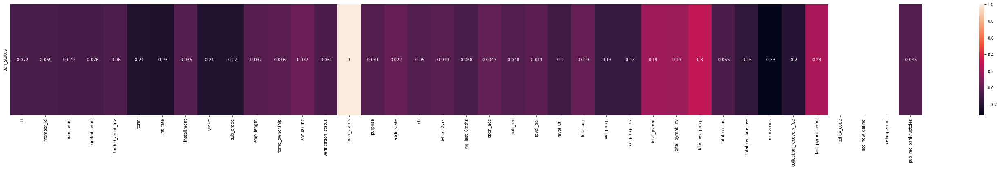

In [65]:
data_correlation = pd.DataFrame(data_encoded.corr()["loan_status"]).T
plt.rcParams["figure.figsize"] = [50,5]#corellation graph
sns.heatmap(data_correlation,xticklabels=data_correlation.columns,yticklabels=["loan_status"],annot=True)

In [66]:
data_correlation

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,loan_status,purpose,addr_state,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,policy_code,acc_now_delinq,delinq_amnt,pub_rec_bankruptcies
loan_status,-0.072152,-0.068501,-0.079476,-0.07635,-0.060091,-0.211644,-0.226822,-0.036132,-0.211936,-0.215516,-0.032216,-0.015578,0.037053,-0.061355,1.0,-0.040771,0.021788,-0.049951,-0.019234,-0.067612,0.004678,-0.048212,-0.011391,-0.101585,0.018919,-0.133108,-0.132967,0.192413,0.187913,0.302839,-0.065559,-0.160246,-0.330683,-0.199591,0.233293,NaN,NaN,NaN,-0.044772


* from picture

In [67]:
data_encoded

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,policy_code,acc_now_delinq,delinq_amnt,pub_rec_bankruptcies
0,1077501,1296599,5000,5000,4975.0,36,10.65,162.87,1,6,US Army,10,3,24000.0,2,2011-12-01,2,1,Computer,860xx,3,27.65,0,1985-01-01,1,3,0,13648,83.7,9,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,2015-01-01,171.62,2016-05-01,1,0,0,0.0
1,1077430,1314167,2500,2500,2500.0,60,15.27,59.83,2,13,Ryder,1,3,30000.0,1,2011-12-01,0,0,bike,309xx,10,1.00,0,1999-04-01,5,3,0,1687,9.4,4,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,2013-04-01,119.66,2013-09-01,1,0,0,0.0
2,1077175,1313524,2400,2400,2400.0,36,15.96,84.33,2,14,US Army,10,3,12252.0,0,2011-12-01,2,11,real estate business,606xx,14,8.72,0,2001-11-01,2,2,0,2956,98.5,10,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,2014-06-01,649.91,2016-05-01,1,0,0,0.0
3,1076863,1277178,10000,10000,10000.0,36,13.49,339.31,2,10,AIR RESOURCES BOARD,10,3,49200.0,1,2011-12-01,2,9,personel,917xx,4,20.00,0,1996-02-01,1,10,0,5598,21.0,37,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,2015-01-01,357.48,2016-04-01,1,0,0,0.0
4,1075358,1311748,3000,3000,3000.0,60,12.69,67.79,1,9,University Medical Group,1,3,80000.0,1,2011-12-01,1,9,Personal,972xx,36,17.94,0,1996-01-01,0,15,0,27783,53.9,38,524.06,524.06,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,2016-05-01,67.79,2016-05-01,1,0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,92187,92174,2500,2500,1075.0,36,8.07,78.42,0,3,FiSite Research,4,0,110000.0,0,2007-07-01,2,4,Home Improvement,802xx,5,11.33,0,1990-11-01,0,13,0,7274,13.1,40,0.00,0.00,2822.969293,1213.88,2500.00,322.97,0.00,0.00,0.00,2010-07-01,80.90,2010-06-01,1,0,0,0.0
39713,90665,90607,8500,8500,875.0,36,10.28,275.38,2,10,"Squarewave Solutions, Ltd.",3,3,18000.0,0,2007-07-01,2,1,Retiring credit card debt,274xx,27,6.40,1,1986-12-01,1,6,0,8847,26.9,9,0.00,0.00,9913.491822,1020.51,8500.00,1413.49,0.00,0.00,0.00,2010-07-01,281.94,2010-07-01,1,0,0,0.0
39714,90395,90390,5000,5000,1325.0,36,8.07,156.84,0,3,US Army,1,0,100000.0,0,2007-07-01,2,2,MBA Loan Consolidation,017xx,19,2.30,0,1998-10-01,0,11,0,9698,19.4,20,0.00,0.00,5272.161128,1397.12,5000.00,272.16,0.00,0.00,0.00,2008-04-01,0.00,2007-06-01,1,0,0,0.0
39715,90376,89243,5000,5000,650.0,36,7.43,155.38,0,1,US Army,1,0,200000.0,0,2007-07-01,2,9,JAL Loan,208xx,20,3.72,0,1988-11-01,0,17,0,85607,0.7,26,0.00,0.00,5174.198551,672.66,5000.00,174.20,0.00,0.00,0.00,2008-01-01,0.00,2007-06-01,1,0,0,0.0


In [68]:
tr2 = go.Bar(
            x = df[df["loan_status"]== 'Current']["verification_status"].value_counts().index.values,
            y = df[df["loan_status"]== 'Current']["verification_status"].value_counts().values,
            name='Current'
    )
tr0 = go.Bar(
            x = df[df["loan_status"]== 'Charged Off']["verification_status"].value_counts().index.values,
            y = df[df["loan_status"]== 'Charged Off']["verification_status"].value_counts().values,
            name='Charged Off'
    )

tr1 = go.Bar(
            x = df[df["loan_status"]== 'Fully Paid']["verification_status"].value_counts().index.values,
            y = df[df["loan_status"]== 'Fully Paid']["verification_status"].value_counts().values,
            name='Fully Paid'
    )


data = [tr2, tr0,tr1]

layout = go.Layout(
    
)

layout = go.Layout(
    yaxis=dict(
        title='Count'
    ),
    xaxis=dict(
        title='verification_status'
    ),
    title='Dependent variable distribution'
)

fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='grouped-bar')

In [69]:
tr2 = go.Bar(
            x = df[df["loan_status"]== 'Current']["home_ownership"].value_counts().index.values,
            y = df[df["loan_status"]== 'Current']["home_ownership"].value_counts().values,
            name='Current'
    )
tr0 = go.Bar(
            x = df[df["loan_status"]== 'Charged Off']["home_ownership"].value_counts().index.values,
            y = df[df["loan_status"]== 'Charged Off']["home_ownership"].value_counts().values,
            name='Charged Off'
    )

tr1 = go.Bar(
            x = df[df["loan_status"]== 'Fully Paid']["home_ownership"].value_counts().index.values,
            y = df[df["loan_status"]== 'Fully Paid']["home_ownership"].value_counts().values,
            name='Fully Paid'
    )


data = [tr2, tr0,tr1]

layout = go.Layout(
    
)

layout = go.Layout(
    yaxis=dict(
        title='Count'
    ),
    xaxis=dict(
        title='verification_status'
    ),
    title='Dependent variable distribution'
)

fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='grouped-bar')

In [70]:
tr2 = go.Bar(
            x = df[df["loan_status"]== 'Current']["grade"].value_counts().index.values,
            y = df[df["loan_status"]== 'Current']["grade"].value_counts().values,
            name='Current'
    )
tr0 = go.Bar(
            x = df[df["loan_status"]== 'Charged Off']["grade"].value_counts().index.values,
            y = df[df["loan_status"]== 'Charged Off']["grade"].value_counts().values,
            name='Charged Off'
    )

tr1 = go.Bar(
            x = df[df["loan_status"]== 'Fully Paid']["grade"].value_counts().index.values,
            y = df[df["loan_status"]== 'Fully Paid']["grade"].value_counts().values,
            name='Fully Paid'
    )


data = [tr2, tr0,tr1]

layout = go.Layout(
    
)

layout = go.Layout(
    yaxis=dict(
        title='Count'
    ),
    xaxis=dict(
        title='verification_status'
    ),
    title='Dependent variable distribution'
)

fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='grouped-bar')

In [71]:
col = "int_rate"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall "
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

C:\Users\LOKSUNDAR\anaconda3\lib\site-packages\plotly\tools.py:461: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [72]:
df["term"].value_counts()

36    29096
60    10621
Name: term, dtype: int64

In [73]:
col = "term"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid",
    nbinsx=2
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off",
    nbinsx=2
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall ",
    nbinsx=2
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [74]:
df["total_rec_prncp"].value_counts()

10000.00    2293
12000.00    1805
5000.00     1702
6000.00     1637
15000.00    1400
            ... 
1097.81        1
1410.30        1
6968.65        1
3477.49        1
16077.42       1
Name: total_rec_prncp, Length: 7976, dtype: int64

In [75]:
col = "total_rec_prncp"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall "
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [76]:
df["recoveries"].value_counts()

0.00       35499
11.29          4
10.40          4
10.66          3
44.92          3
           ...  
764.69         1
653.08         1
1080.96        1
878.19         1
21.29          1
Name: recoveries, Length: 4040, dtype: int64

In [77]:
col = "recoveries"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall "
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [78]:
fig = tls.make_subplots(rows=1, cols=1)
tr = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
fig.append_trace(tr, 1, 1)
fig.update_layout(
    title_text='Charged Off', # title of plot
    xaxis_title_text=col, # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.1, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.show()

In [79]:
df["collection_recovery_fee"].value_counts()

0.0000      35935
2.0000         12
1.2000         10
3.7100          9
1.8800          8
            ...  
3.7900          1
773.4900        1
272.8250        1
1.7697          1
0.2300          1
Name: collection_recovery_fee, Length: 2616, dtype: int64

In [80]:
col = "collection_recovery_fee"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall "
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [81]:
fig = tls.make_subplots(rows=1, cols=1)
tr = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
fig.append_trace(tr, 1, 1)
fig.update_layout(
    title_text='Charged Off', # title of plot
    xaxis_title_text=col, # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.1, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.show()

In [82]:
df["last_pymnt_amnt"].value_counts()

0.00       74
276.06     21
200.00     17
50.00      16
100.00     15
           ..
1763.87     1
172.27      1
889.67      1
150.73      1
256.59      1
Name: last_pymnt_amnt, Length: 34930, dtype: int64

In [83]:
col = "last_pymnt_amnt"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall "
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [84]:
col = "total_pymnt"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall "
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

In [85]:
fig = tls.make_subplots(rows=1, cols=1)
tr = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
fig.append_trace(tr, 1, 1)
fig.update_layout(
    title_text='Charged Off', # title of plot
    xaxis_title_text=col, # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.1, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
)
fig.show()

In [86]:
col = "total_pymnt_inv"
df_good = df.loc[df["loan_status"] == 'Fully Paid'][col].values.tolist()
df_bad = df.loc[df["loan_status"] == 'Charged Off'][col].values.tolist()
df_age = df[col].values.tolist()

#First plot
tr0 = go.Histogram(
    x=df_good,
    histnorm='probability',
    name="Fully Paid"
)
#Second plot
tr1 = go.Histogram(
    x=df_bad,
    histnorm='probability',
    name="Charged off"
)
#Third plot
tr2 = go.Histogram(
    x=df_age,
    histnorm='probability',
    name="Overall "
)

#Creating the grid
fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                          subplot_titles=('Fully Paid','Charged Off', 'General Distribuition'))

#setting the figs
fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 2, 1)

fig['layout'].update(showlegend=True, title=col+' Distribuition', bargap=0.05)
py.iplot(fig, filename='custom-sized-subplot-with-subplot-titles')

C:\Users\LOKSUNDAR\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\LOKSUNDAR\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



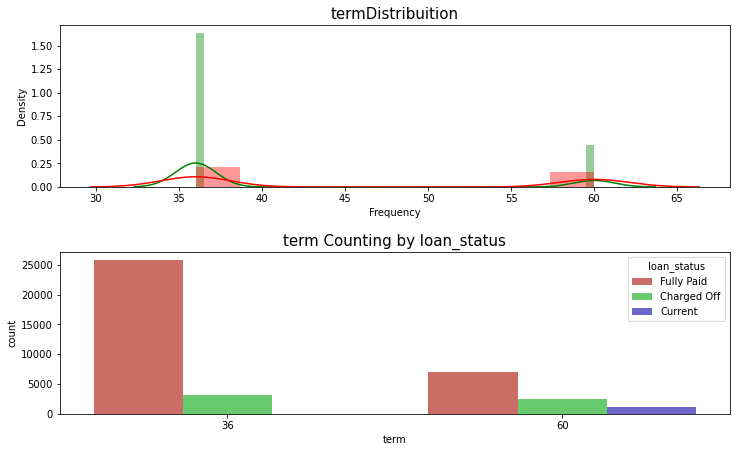

In [87]:
col = "term"
df_good = df[df["loan_status"] == 'Fully Paid']
df_bad = df[df["loan_status"] == 'Charged Off']
fig, ax = plt.subplots(nrows=2, figsize=(12,8))
plt.subplots_adjust(hspace = 0.4, top = 0.8)

g1 = sns.distplot(df_good[col], ax=ax[0], 
             color="g")
g1 = sns.distplot(df_bad[col], ax=ax[0], 
             color='r')
g1.set_title(col+"Distribuition", fontsize=15)
g1.set_xlabel(col)
g1.set_xlabel("Frequency")

g2 = sns.countplot(x=col,data=df, 
              palette="hls", ax=ax[1], 
              hue = "loan_status")
g2.set_title(col+" Counting by loan_status", fontsize=15)
g2.set_xlabel(col)
plt.show()


C:\Users\LOKSUNDAR\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\LOKSUNDAR\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



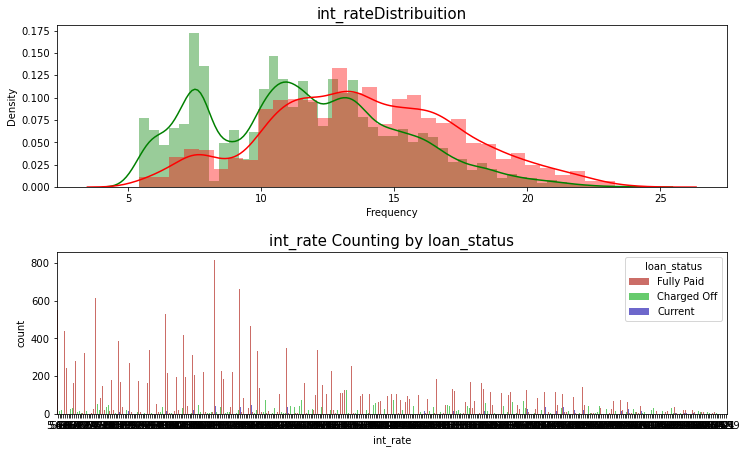

In [88]:
col = "int_rate"
df_good = df[df["loan_status"] == 'Fully Paid']
df_bad = df[df["loan_status"] == 'Charged Off']
fig, ax = plt.subplots(nrows=2, figsize=(12,8))
plt.subplots_adjust(hspace = 0.4, top = 0.8)

g1 = sns.distplot(df_good[col], ax=ax[0], 
             color="g")
g1 = sns.distplot(df_bad[col], ax=ax[0], 
             color='r')
g1.set_title(col+"Distribuition", fontsize=15)
g1.set_xlabel(col)
g1.set_xlabel("Frequency")

g2 = sns.countplot(x=col,data=df, 
              palette="hls", ax=ax[1], 
              hue = "loan_status")
g2.set_title(col+" Counting by loan_status", fontsize=15)
g2.set_xlabel(col)
plt.show()


In [89]:
#Distribuition of Credit Amount by Housing
fig = {
    "data": [
        {
            "type": 'violin',
            "x": df_good['home_ownership'],
            "y": df_good['loan_amnt'],
            "legendgroup": 'Fully Paid',
            "scalegroup": 'No',
            "name": 'Fully Paid',
            "side": 'negative',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'blue'
            }
        },
        {
            "type": 'violin',
            "x": df_bad['home_ownership'],
            "y": df_bad['loan_amnt'],
            "legendgroup": 'Charged Off',
            "scalegroup": 'No',
            "name": 'Charged Off',
            "side": 'positive',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'green'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "zeroline": False,
        },
        "violingap": 0,
        "violinmode": "overlay"
    }
}


py.iplot(fig, filename = 'violin/split', validate = False)

In [90]:
#Distribuition of Credit Amount by Housing
fig = {
    "data": [
        {
            "type": 'violin',
            "x": df_good['home_ownership'],
            "y": df_good['funded_amnt'],
            "legendgroup": 'Fully Paid',
            "scalegroup": 'No',
            "name": 'Fully Paid',
            "side": 'negative',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'blue'
            }
        },
        {
            "type": 'violin',
            "x": df_bad['home_ownership'],
            "y": df_bad['funded_amnt'],
            "legendgroup": 'Charged Off',
            "scalegroup": 'No',
            "name": 'Charged Off',
            "side": 'positive',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'green'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "zeroline": False,
        },
        "violingap": 0,
        "violinmode": "overlay"
    }
}


py.iplot(fig, filename = 'violin/split', validate = False)

In [91]:
#Distribuition of Credit Amount by Housing
fig = {
    "data": [
        {
            "type": 'violin',
            "x": df_good['grade'],
            "y": df_good['loan_amnt'],
            "legendgroup": 'Fully Paid',
            "scalegroup": 'No',
            "name": 'Fully Paid',
            "side": 'negative',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'blue'
            }
        },
        {
            "type": 'violin',
            "x": df_bad['grade'],
            "y": df_bad['loan_amnt'],
            "legendgroup": 'Charged Off',
            "scalegroup": 'No',
            "name": 'Charged Off',
            "side": 'positive',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'green'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "zeroline": False,
        },
        "violingap": 0,
        "violinmode": "overlay"
    }
}


py.iplot(fig, filename = 'violin/split', validate = False)

In [92]:
#Distribuition of Credit Amount by Housing
fig = {
    "data": [
        {
            "type": 'violin',
            "x": df_good['grade'],
            "y": df_good['funded_amnt'],
            "legendgroup": 'Fully Paid',
            "scalegroup": 'No',
            "name": 'Fully Paid',
            "side": 'negative',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'blue'
            }
        },
        {
            "type": 'violin',
            "x": df_bad['grade'],
            "y": df_bad['funded_amnt'],
            "legendgroup": 'Charged Off',
            "scalegroup": 'No',
            "name": 'Charged Off',
            "side": 'positive',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'green'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "zeroline": False,
        },
        "violingap": 0,
        "violinmode": "overlay"
    }
}


py.iplot(fig, filename = 'violin/split', validate = False)

In [93]:
#Distribuition of Credit Amount by Housing
fig = {
    "data": [
        {
            "type": 'violin',
            "x": df_good['verification_status'],
            "y": df_good['loan_amnt'],
            "legendgroup": 'Fully Paid',
            "scalegroup": 'No',
            "name": 'Fully Paid',
            "side": 'negative',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'blue'
            }
        },
        {
            "type": 'violin',
            "x": df_bad['verification_status'],
            "y": df_bad['loan_amnt'],
            "legendgroup": 'Charged Off',
            "scalegroup": 'No',
            "name": 'Charged Off',
            "side": 'positive',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'green'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "zeroline": False,
        },
        "violingap": 0,
        "violinmode": "overlay"
    }
}


py.iplot(fig, filename = 'violin/split', validate = False)

In [94]:
#Distribuition of Credit Amount by Housing
fig = {
    "data": [
        {
            "type": 'violin',
            "x": df_good['verification_status'],
            "y": df_good['funded_amnt'],
            "legendgroup": 'Fully Paid',
            "scalegroup": 'No',
            "name": 'Fully Paid',
            "side": 'negative',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'blue'
            }
        },
        {
            "type": 'violin',
            "x": df_bad['verification_status'],
            "y": df_bad['funded_amnt'],
            "legendgroup": 'Charged Off',
            "scalegroup": 'No',
            "name": 'Charged Off',
            "side": 'positive',
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            },
            "line": {
                "color": 'green'
            }
        }
    ],
    "layout" : {
        "yaxis": {
            "zeroline": False,
        },
        "violingap": 0,
        "violinmode": "overlay"
    }
}


py.iplot(fig, filename = 'violin/split', validate = False)

In [95]:
tr0 = go.Box(
    y=df_good["loan_amnt"],
    x=df_good["verification_status"],
    name='FUlly paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_bad['loan_amnt'],
    x=df_bad['verification_status'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount',
        zeroline=False
    ),
    xaxis=dict(
        title='Verification Categorical'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

In [96]:

tr0 = go.Box(
    y=df_good["funded_amnt"],
    x=df_good["verification_status"],
    name='FUlly paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_bad['funded_amnt'],
    x=df_bad['verification_status'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount',
        zeroline=False
    ),
    xaxis=dict(
        title='Verification Categorical'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')

In [97]:
tr0 = go.Box(
    y=df_good["loan_amnt"],
    x=df_good["home_ownership"],
    name='FUlly paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_bad['loan_amnt'],
    x=df_bad['home_ownership'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount',
        zeroline=False
    ),
    xaxis=dict(
        title='Verification Categorical'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')


In [98]:
tr0 = go.Box(
    y=df_good["funded_amnt"],
    x=df_good["home_ownership"],
    name='FUlly paid',
    marker=dict(
        color='#3D9970'
    )
)

tr1 = go.Box(
    y=df_bad['funded_amnt'],
    x=df_bad['home_ownership'],
    name='Charged Off',
    marker=dict(
        color='#FF4136'
    )
)
    
data = [tr0, tr1]

layout = go.Layout(
    yaxis=dict(
        title='Loan Amount',
        zeroline=False
    ),
    xaxis=dict(
        title='Verification Categorical'
    ),
    boxmode='group'
)
fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='box-age-cat')